In [137]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import plotly.express as px
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

## Prepare data for analysis

In [2]:
files=os.listdir(r'D:\python\python material\python projects\Project 8-- Uber New York Data Analysis\uber-pickups-in-new-york-city')[-7:]

In [3]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [4]:
%cd "Project 8-- Uber New York Data Analysis"

D:\python\python material\python projects\Project 8-- Uber New York Data Analysis


In [5]:
%cd uber-pickups-in-new-york-city/

D:\python\python material\python projects\Project 8-- Uber New York Data Analysis\uber-pickups-in-new-york-city


In [6]:
frame1=pd.read_csv('uber-raw-data-apr14.csv')
frame2=pd.read_csv('uber-raw-data-aug14.csv')
frame3=pd.read_csv('uber-raw-data-jul14.csv')
frame4=pd.read_csv('uber-raw-data-jun14.csv')
frame5=pd.read_csv('uber-raw-data-may14.csv')
frame6=pd.read_csv('uber-raw-data-sep14.csv')

In [7]:
dframe=pd.concat([frame1,frame2,frame3,frame4,frame5,frame6])

In [8]:
dframe.shape

(4534327, 4)

In [9]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [10]:
dframe

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
...,...,...,...,...
1028131,9/30/2014 22:57:00,40.7668,-73.9845,B02764
1028132,9/30/2014 22:57:00,40.6911,-74.1773,B02764
1028133,9/30/2014 22:58:00,40.8519,-73.9319,B02764
1028134,9/30/2014 22:58:00,40.7081,-74.0066,B02764


In [11]:
dframe.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [12]:
dframe['Date/Time']=pd.to_datetime(dframe['Date/Time'],format='%m/%d/%Y %H:%M:%S')

In [13]:
dframe.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [14]:
dframe.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


In [15]:
dframe['Weekdays']=dframe['Date/Time'].dt.day_name()

In [16]:
dframe.head(20000)

,Date/Time,Lat,Lon,Base,Weekdays
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday
...,...,...,...,...,...
19995,2014-04-17 18:12:00,40.7503,-73.9788,B02512,Thursday
19996,2014-04-17 18:12:00,40.7226,-74.0052,B02512,Thursday
19997,2014-04-17 18:13:00,40.7842,-73.9549,B02512,Thursday
19998,2014-04-17 18:13:00,40.7446,-73.9890,B02512,Thursday


In [17]:
dframe['Day']=dframe['Date/Time'].dt.day

In [18]:
dframe

,Date/Time,Lat,Lon,Base,Weekdays,Day
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1
...,...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,Tuesday,30
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,Tuesday,30
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,Tuesday,30
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,Tuesday,30


In [19]:
dframe['Minutes']=dframe['Date/Time'].dt.minute
dframe['Month']=dframe['Date/Time'].dt.month
dframe['Hour']=dframe['Date/Time'].dt.hour

In [20]:
dframe

,Date/Time,Lat,Lon,Base,Weekdays,Day,Minutes,Month,Hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0
...,...,...,...,...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,Tuesday,30,57,9,22
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,Tuesday,30,57,9,22
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,Tuesday,30,58,9,22
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,Tuesday,30,58,9,22


## Analysis of which weekday has most rides

In [21]:
dframe.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
Weekdays             object
Day                   int64
Minutes               int64
Month                 int64
Hour                  int64
dtype: object

In [22]:
dframe['Weekdays'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Weekdays, dtype: int64

In [23]:
px.bar(x=dframe['Weekdays'].value_counts().index,
       y=dframe['Weekdays'].value_counts(),title='WeekDays bar graph')

## Analysis of which hour has most rides

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

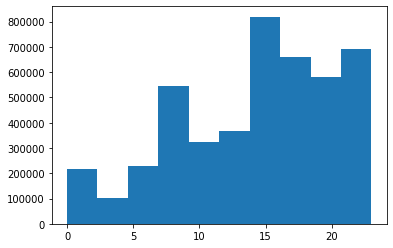

In [24]:
plt.hist(dframe['Hour'])

## Analysis of which hour in which month has max rides

In [25]:
dframe['Month'].unique()

array([4, 8, 7, 6, 5, 9], dtype=int64)

In [26]:
for i,month in enumerate(dframe['Month'].unique()):
    print(i,month)

0 4
1 8
2 7
3 6
4 5
5 9


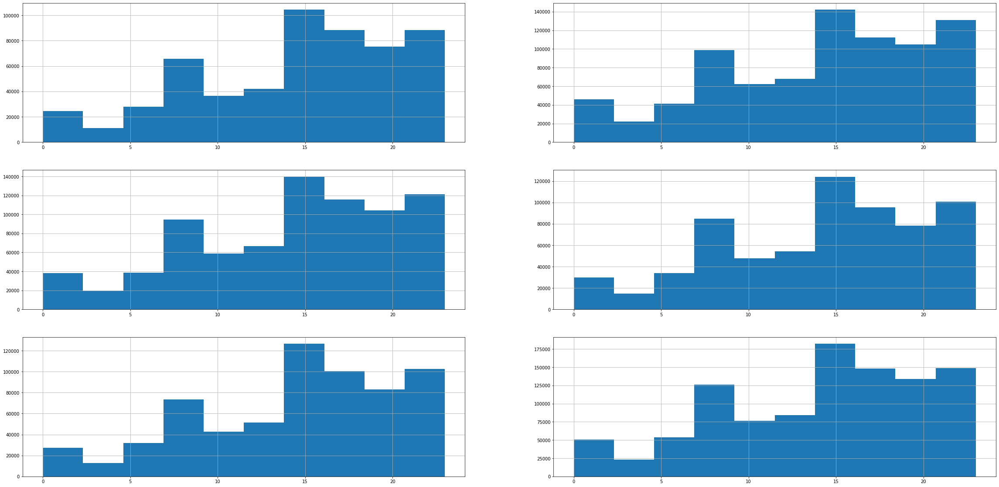

In [27]:
plt.figure(figsize=(40,20))
for i,month in enumerate(dframe['Month'].unique()):
    plt.subplot(3,2,i+1)
    dframe[dframe['Month']==month]['Hour'].hist()

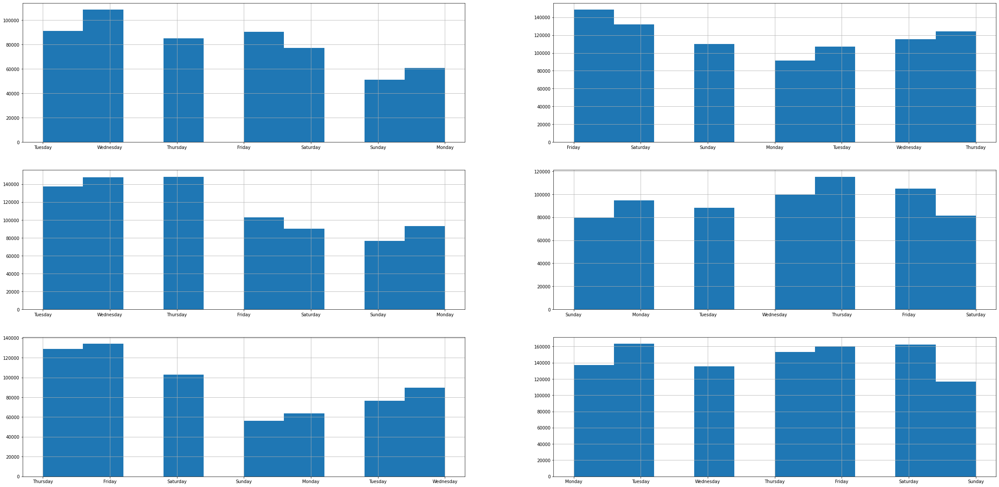

In [28]:
plt.figure(figsize=(40,20))
for i,month in enumerate(dframe['Month'].unique()):
    plt.subplot(3,2,i+1)
    dframe[dframe['Month']==month]['Weekdays'].hist()

## Analysis of which month has max rides

In [29]:
px.bar(x=dframe['Month'].value_counts().index,
       y=dframe['Month'].value_counts(),title='Max rides by months')

In [30]:
dframe.head()

,Date/Time,Lat,Lon,Base,Weekdays,Day,Minutes,Month,Hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


In [32]:
dframe.groupby('Month')['Hour'].count()

Month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: Hour, dtype: int64

In [33]:
dframe['Month'].value_counts()

9    1028136
8     829275
7     796121
6     663844
5     652435
4     564516
Name: Month, dtype: int64

In [34]:
trace1=go.Bar(x=dframe.groupby('Month')['Hour'].count().index,
      y=dframe.groupby('Month')['Hour'].count(),
      name='Priority')

In [35]:
iplot([trace1])

In [36]:
px.bar(x=dframe['Month'].value_counts().index,
       y=dframe['Month'].value_counts(),title='Max rides by months')

## Analysis of Journey by each day

In [37]:
dframe

,Date/Time,Lat,Lon,Base,Weekdays,Day,Minutes,Month,Hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0
...,...,...,...,...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,Tuesday,30,57,9,22
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,Tuesday,30,57,9,22
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,Tuesday,30,58,9,22
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,Tuesday,30,58,9,22


Text(0.5, 1.0, 'Journey by Month Day')

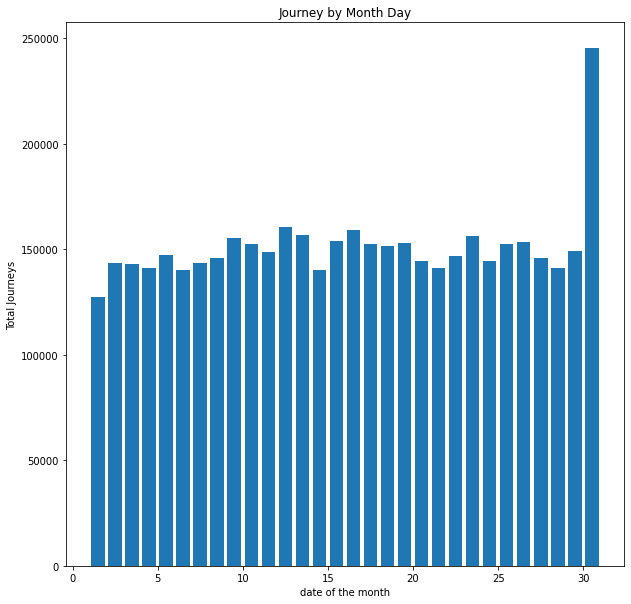

In [38]:
plt.figure(figsize=(10,10))
plt.hist(dframe['Day'],bins=30, rwidth=0.8)
plt.xlabel('date of the month')
plt.ylabel('Total Journeys')
plt.title('Journey by Month Day')

Text(0.5, 1.0, 'Journey by Month Day')

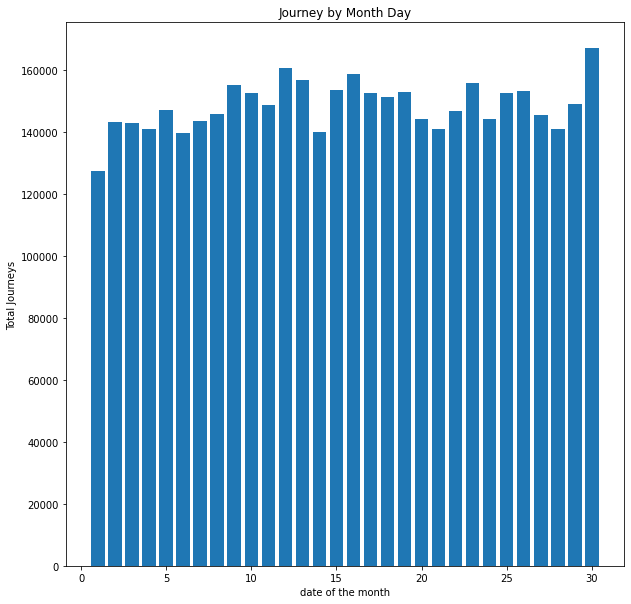

In [39]:
plt.figure(figsize=(10,10))
plt.hist(dframe['Day'],bins=30, rwidth=0.8,range=(0.5,30.5))
plt.xlabel('date of the month')
plt.ylabel('Total Journeys')
plt.title('Journey by Month Day')

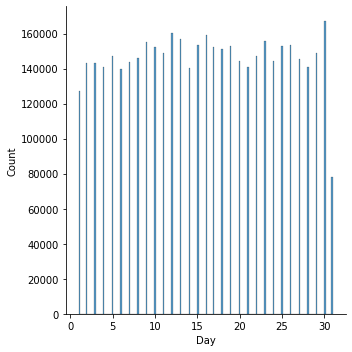

In [40]:
sns.displot(dframe['Day'])

In [41]:
dframe['Month'].unique()

array([4, 8, 7, 6, 5, 9], dtype=int64)

## Analysis of total rides Month Wise

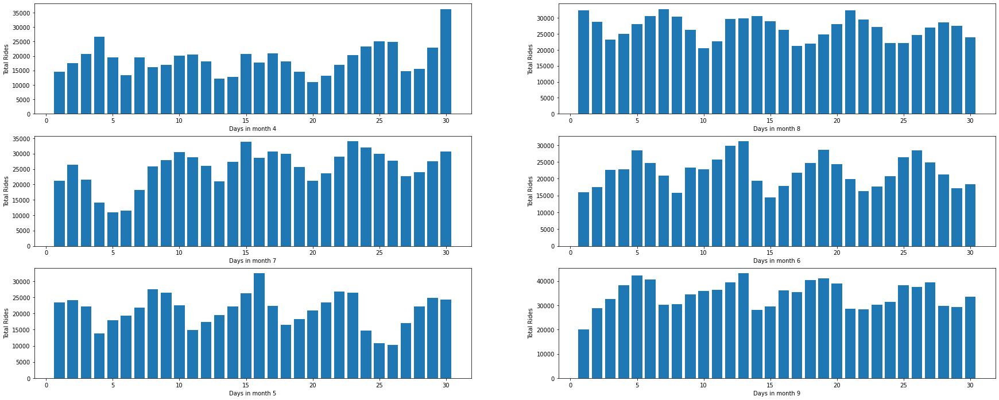

In [42]:
plt.figure(figsize=(30,12))
for index,month in enumerate(dframe['Month'].unique(),1):
    plt.subplot(3,2,index)
    new_df=dframe[dframe['Month']==month]
    plt.hist(new_df['Day'],bins=30, rwidth=0.8,range=(0.5,30.5))
    plt.xlabel('Days in month {}'.format(month))
    plt.ylabel('Total Rides')

## Analysis of Rush in hour

Text(0.5, 1.0, 'Hour of day VS Latitude of passenger')

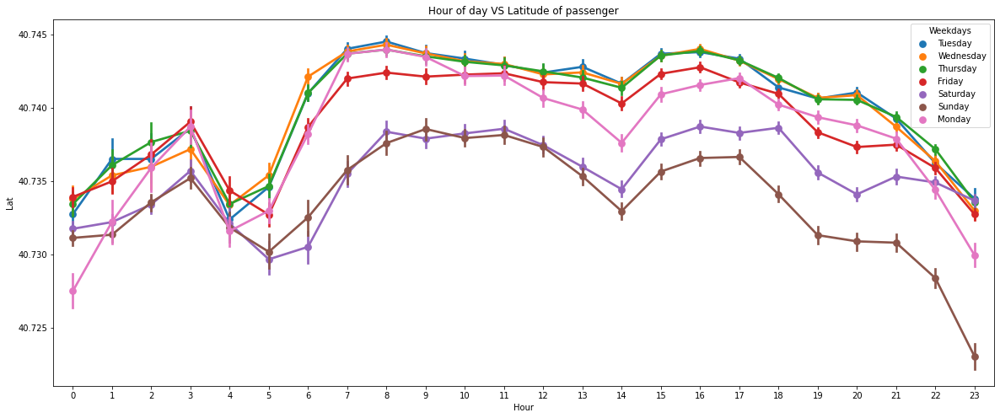

In [43]:
plt.figure(figsize=(20,8))
ax=sns.pointplot(x='Hour',y='Lat',data=dframe,hue='Weekdays')
ax.set_title('Hour of day VS Latitude of passenger')


## Analysis of which base number gets popular by month

In [35]:
base=dframe.groupby(['Base','Month'])['Date/Time'].count().reset_index()

In [36]:
base

,Base,Month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


In [38]:
base.shape

(30, 3)

<AxesSubplot:xlabel='Month', ylabel='Date/Time'>

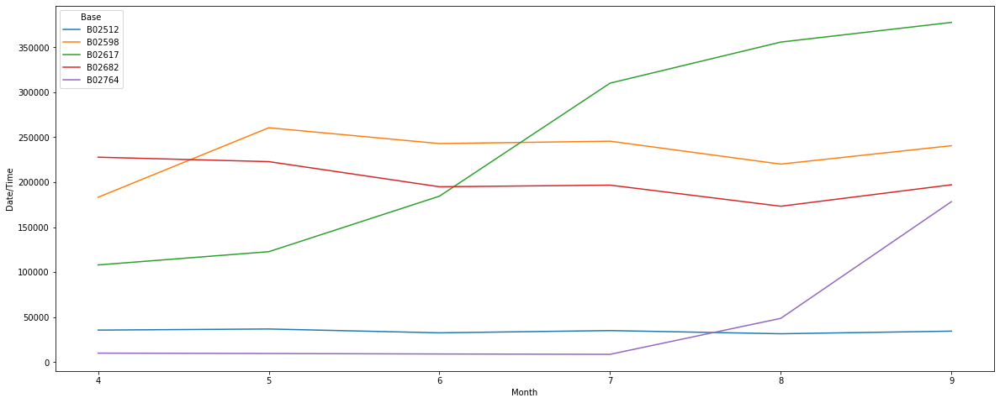

In [40]:
plt.figure(figsize=(20,8))
sns.lineplot(x='Month',y='Date/Time',hue='Base', data=base)

## Cross Analysis:

In [110]:
def count_rows(rows):
    return len(rows)

## 1. Heatmap by hour and weekday

In [111]:
weekday_hour

Weekdays   Hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Name: Date/Time, Length: 168, dtype: int64

In [112]:
pivot_weekday_hour=weekday_hour.unstack()

In [113]:
pivot_weekday_hour

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekdays,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<AxesSubplot:xlabel='Hour', ylabel='Weekdays'>

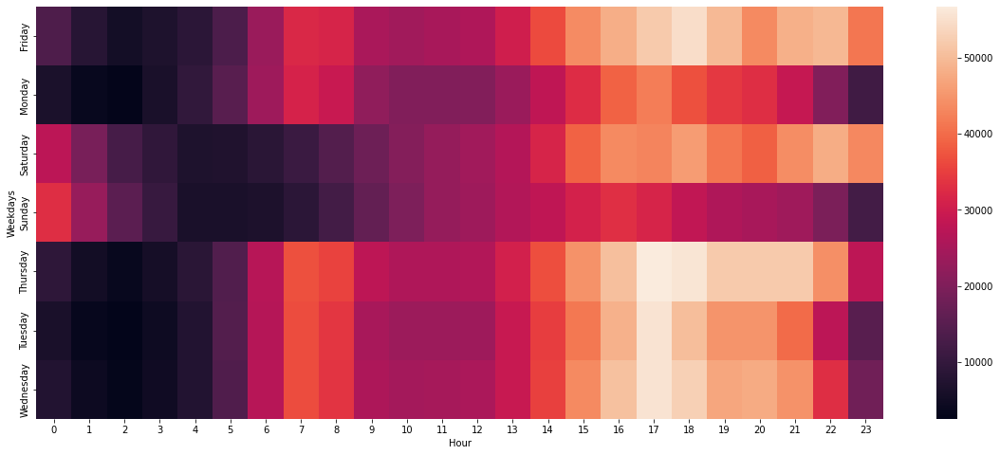

In [114]:
plt.figure(figsize=(20,8))
sns.heatmap(pivot_weekday_hour)

## 2.Heatmap by Hour and Day

In [115]:
day_hour=dframe.groupby(['Day','Hour']).apply(count_rows)

In [116]:
pivot_day_hour=day_hour.unstack()

In [117]:
pivot_day_hour

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day,,,,,,,,,,,,,,,,,,,,,
1,3247,1982,1284,1331,1458,2171,3717,5470,5376,4688,...,7050,8033,8760,9661,8727,8146,7448,7960,6397,4128
2,2480,1600,1109,1442,1897,2861,5002,6646,6420,4795,...,7021,8581,10267,11301,11326,9654,8903,8506,7111,5247
3,3415,2176,1434,1489,1578,2437,4318,5775,5482,4732,...,7327,8991,10472,10665,11433,9765,9158,8646,7246,4767
4,2944,1718,1217,1449,1737,2623,4687,6146,5799,4814,...,7307,8678,9661,10550,10458,9296,8508,8804,7852,5224
5,2786,1567,1047,1278,1648,2958,4919,6379,6580,5616,...,7072,8453,9770,10887,10324,9582,9512,9785,9020,6640
6,4623,2932,1902,1599,1584,2201,3705,4846,5009,4482,...,7353,8751,9615,10130,9437,8575,8286,8734,8000,6061
7,3715,2326,1533,1622,1793,2464,4172,5649,5459,4706,...,7418,8624,10585,11185,10767,9674,8862,8692,7337,4902
8,2882,1672,1147,1509,1921,3282,5528,7474,7472,5770,...,7356,8910,10007,10871,9874,8964,8768,8528,6917,4331
9,2708,1757,1246,1501,1911,3227,5910,7720,7641,5983,...,7997,9360,10419,12116,11677,9979,9061,8806,7637,5290


<AxesSubplot:xlabel='Hour', ylabel='Day'>

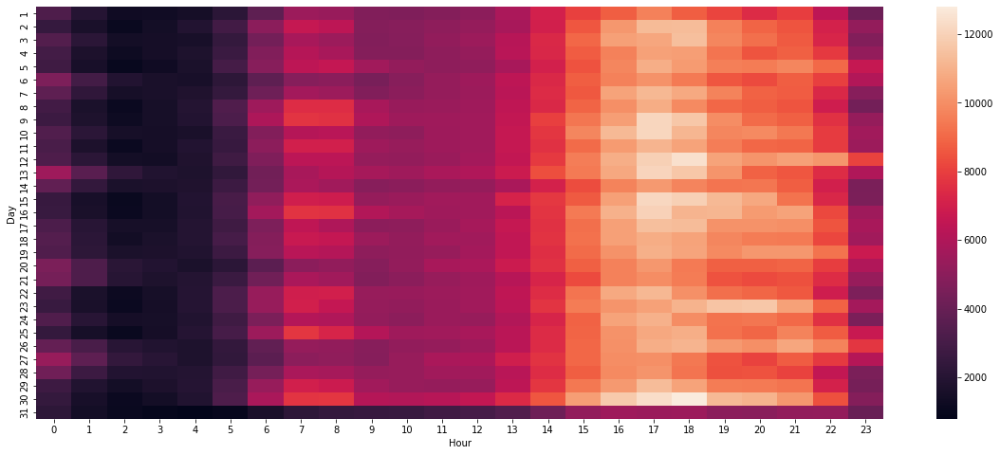

In [118]:
plt.figure(figsize=(20,8))
sns.heatmap(pivot_day_hour)

## 3. Heatmap by Month and Day

In [119]:
month_day=dframe.groupby(['Month','Day']).apply(count_rows)

In [120]:
month_day

Month  Day
4      1      14546
       2      17474
       3      20701
       4      26714
       5      19521
              ...  
9      26     37504
       27     39468
       28     29656
       29     29201
       30     33431
Length: 183, dtype: int64

In [121]:
pivot_month_day=month_day.unstack()

In [122]:
pivot_month_day

Day,1,2,3,4,5,6,7,8,9,10,...,22,23,24,25,26,27,28,29,30,31
Month,,,,,,,,,,,,,,,,,,,,,
4,14546.0,17474.0,20701.0,26714.0,19521.0,13445.0,19550.0,16188.0,16843.0,20041.0,...,16975.0,20346.0,23352.0,25095.0,24925.0,14677.0,15475.0,22835.0,36251.0,NaN
5,23375.0,24235.0,22234.0,13918.0,17859.0,19300.0,21891.0,27513.0,26385.0,22550.0,...,26802.0,26465.0,14651.0,10841.0,10202.0,17004.0,22240.0,24930.0,24413.0,21261.0
6,15967.0,17503.0,22674.0,22831.0,28371.0,24683.0,20889.0,15749.0,23244.0,22874.0,...,16322.0,17735.0,20779.0,26460.0,28516.0,24895.0,21208.0,17107.0,18395.0,NaN
7,21228.0,26480.0,21597.0,14148.0,10890.0,11443.0,18280.0,25763.0,27817.0,30541.0,...,29029.0,34073.0,32050.0,29975.0,27708.0,22590.0,23981.0,27589.0,30740.0,33541.0
8,32353.0,28678.0,23146.0,24952.0,28094.0,30495.0,32759.0,30411.0,26286.0,20584.0,...,29512.0,27097.0,22036.0,22093.0,24550.0,27018.0,28597.0,27424.0,23930.0,23271.0
9,19961.0,28831.0,32631.0,38360.0,42319.0,40520.0,30134.0,30360.0,34560.0,35910.0,...,28312.0,30316.0,31301.0,38203.0,37504.0,39468.0,29656.0,29201.0,33431.0,NaN


<AxesSubplot:xlabel='Day', ylabel='Month'>

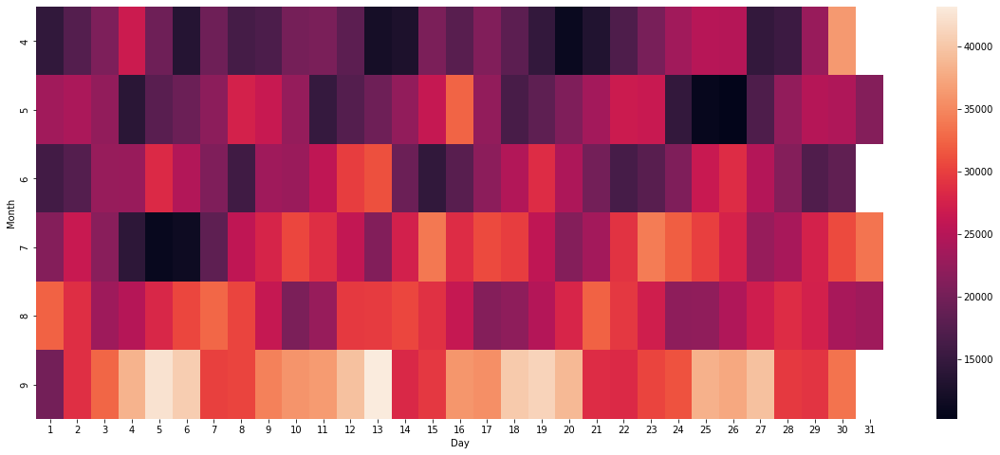

In [123]:
plt.figure(figsize=(20,8))
sns.heatmap(pivot_month_day)

## 4. Heatmap by Month and weekday

In [124]:
month_weekday=dframe.groupby(['Month','Weekdays']).apply(count_rows)
pivot_month_weekday=month_weekday.unstack()

In [125]:
pivot_month_weekday

Weekdays,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
Month,,,,,,,
4,90303,60861,77218,51251,85067,91185,108631
5,133991,63846,102990,56168,128921,76662,89857
6,105056,94655,81364,79656,115325,88134,99654
7,102735,93189,90260,76327,148439,137454,147717
8,148674,91633,132225,110246,124117,107124,115256
9,160380,137288,162057,116532,153276,163230,135373


<AxesSubplot:xlabel='Weekdays', ylabel='Month'>

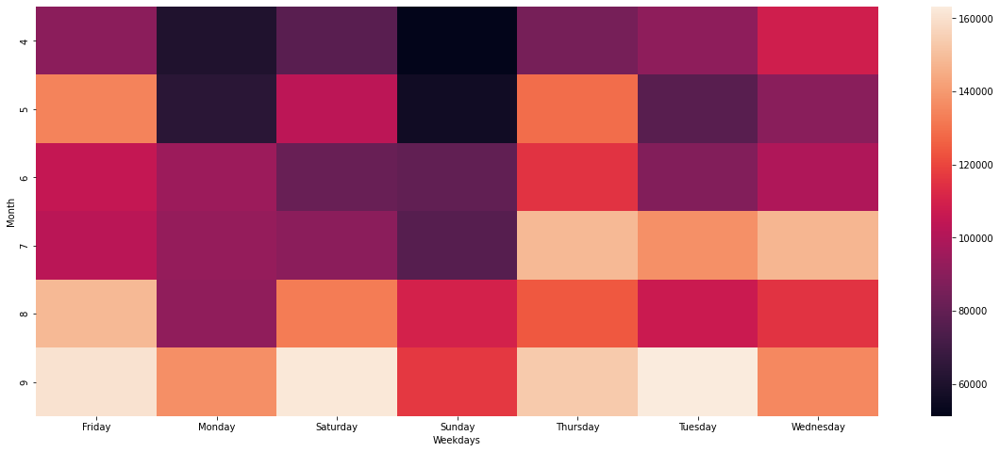

In [126]:
plt.figure(figsize=(20,8))
sns.heatmap(pivot_month_weekday)

## SIMILAR RESULTS OF CROSS ANALYSIS CAN BE ACHIEVED BY WRITING A FUNCTION INSTEAD OF CODING ALL THE STEPS AGAIN AND AGAIN.......

In [127]:
def count_rows(rows):
    return len(rows)

In [128]:
def heatmap():
    para1=input('First Parameter:')
    para2=input('Second Parameter:')
    a=int(input('Length:'))
    b=int(input("Height:"))
    print('----------------------------------------------------')
    para1_para2=dframe.groupby([para1,para2]).apply(count_rows)
    print(para1_para2)
    pivot_para1_para2=para1_para2.unstack()
    print('Your {} and {} pivot table:'.format(para1,para2))
    print(pivot_para1_para2)
    print('Plotting your HeatMAP-------------->')
    plt.figure(figsize=(a,b))
    return sns.heatmap(pivot_para1_para2)

First Parameter:Day
Second Parameter:Hour
Length:20
Height:8
----------------------------------------------------
Day  Hour
1    0       3247
     1       1982
     2       1284
     3       1331
     4       1458
             ... 
31   19      5001
     20      4923
     21      5171
     22      5244
     23      4026
Length: 744, dtype: int64
Your Day and Hour pivot table:
Hour    0     1     2     3     4     5     6     7     8     9   ...    14  \
Day                                                               ...         
1     3247  1982  1284  1331  1458  2171  3717  5470  5376  4688  ...  7050   
2     2480  1600  1109  1442  1897  2861  5002  6646  6420  4795  ...  7021   
3     3415  2176  1434  1489  1578  2437  4318  5775  5482  4732  ...  7327   
4     2944  1718  1217  1449  1737  2623  4687  6146  5799  4814  ...  7307   
5     2786  1567  1047  1278  1648  2958  4919  6379  6580  5616  ...  7072   
6     4623  2932  1902  1599  1584  2201  3705  4846  5009  4482  ..

<AxesSubplot:xlabel='Hour', ylabel='Day'>

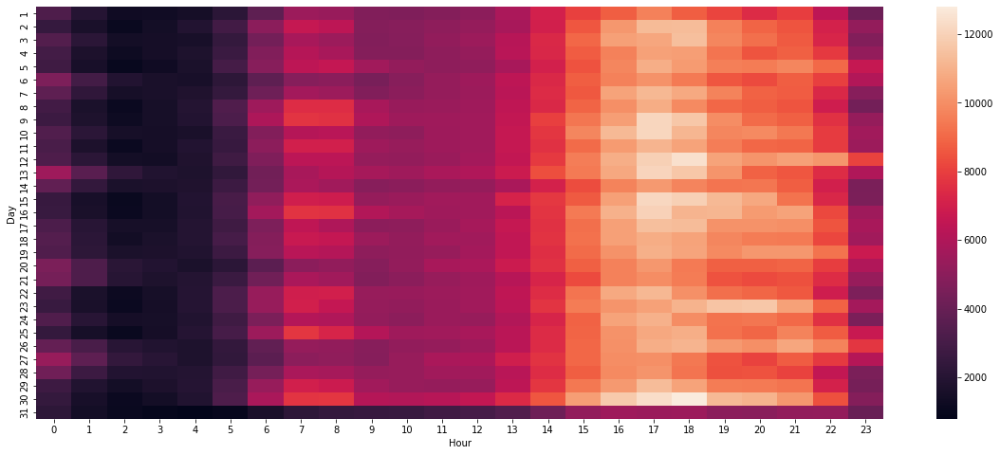

In [129]:
heatmap()

First Parameter:Hour
Second Parameter:Day
Length:20
Height:8
----------------------------------------------------
Hour  Day
0     1      3247
      2      2480
      3      3415
      4      2944
      5      2786
             ... 
23    27     6176
      28     4556
      29     4410
      30     4796
      31     4026
Length: 744, dtype: int64
Your Hour and Day pivot table:
Day     1      2      3      4      5      6      7      8      9      10  \
Hour                                                                        
0     3247   2480   3415   2944   2786   4623   3715   2882   2708   3351   
1     1982   1600   2176   1718   1567   2932   2326   1672   1757   2167   
2     1284   1109   1434   1217   1047   1902   1533   1147   1246   1495   
3     1331   1442   1489   1449   1278   1599   1622   1509   1501   1466   
4     1458   1897   1578   1737   1648   1584   1793   1921   1911   1614   
5     2171   2861   2437   2623   2958   2201   2464   3282   3227   2652   
6    

<AxesSubplot:xlabel='Day', ylabel='Hour'>

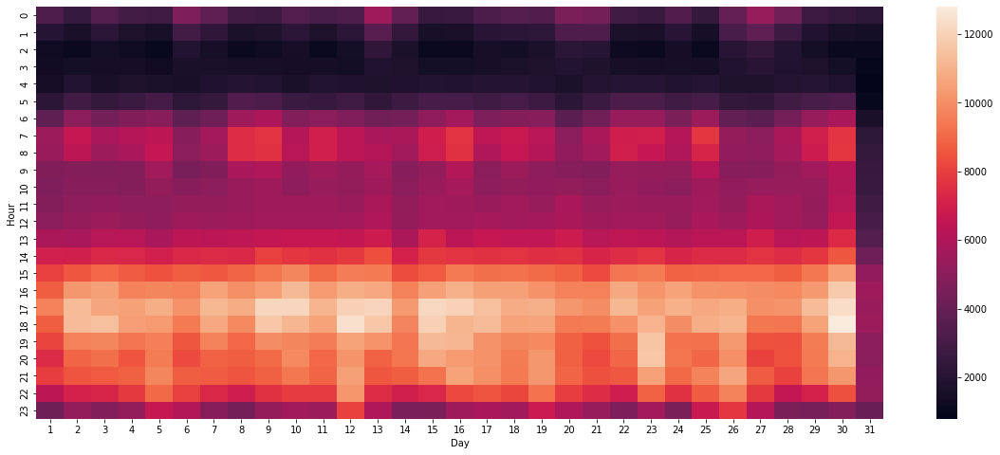

In [130]:
heatmap()

## ANALYSIS OF LOCATION DATA POINTS

In [149]:
dframe

,Date/Time,Lat,Lon,Base,Weekdays,Day,Minutes,Month,Hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0
...,...,...,...,...,...,...,...,...,...
1028131,2014-09-30 22:57:00,40.7668,-73.9845,B02764,Tuesday,30,57,9,22
1028132,2014-09-30 22:57:00,40.6911,-74.1773,B02764,Tuesday,30,57,9,22
1028133,2014-09-30 22:58:00,40.8519,-73.9319,B02764,Tuesday,30,58,9,22
1028134,2014-09-30 22:58:00,40.7081,-74.0066,B02764,Tuesday,30,58,9,22


****LOCATION DATA POINTS ARE "Lat" and "Lon"****

In [147]:
dframe['Lat'].value_counts()

40.7740    15079
40.7741    13885
40.6448    11446
40.7739    10788
40.7406     9144
           ...  
40.2894        1
40.4326        1
40.4463        1
40.5656        1
41.1399        1
Name: Lat, Length: 7092, dtype: int64

In [148]:
dframe['Lon'].value_counts()

-73.9888    12293
-73.9889    11490
-73.9918    11432
-73.9920    10748
-73.9823    10688
            ...  
-73.5323        1
-73.0850        1
-72.3907        1
-73.4956        1
-73.0575        1
Name: Lon, Length: 11453, dtype: int64

(40.5, 41.0)

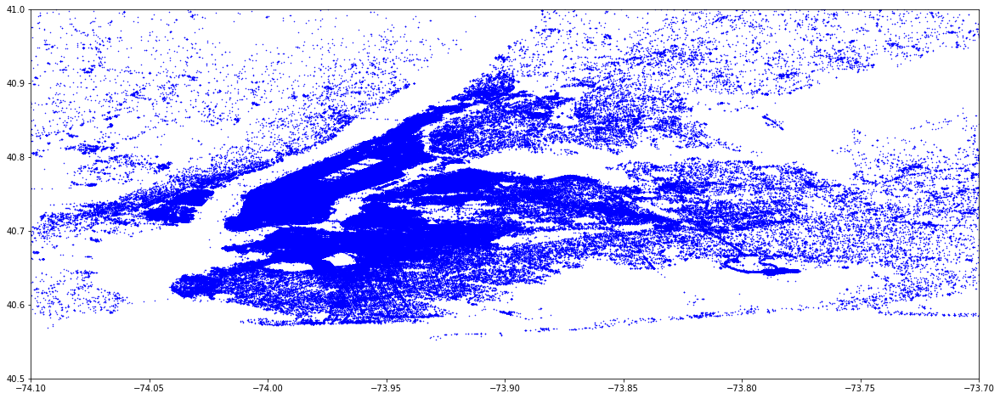

In [158]:
plt.figure(figsize=(20,8))
plt.plot(dframe['Lon'],dframe['Lat'],'bo',ms=0.5)
plt.xlim(-74.1,-73.7)
plt.ylim(40.5,41)

(40.5, 41.0)

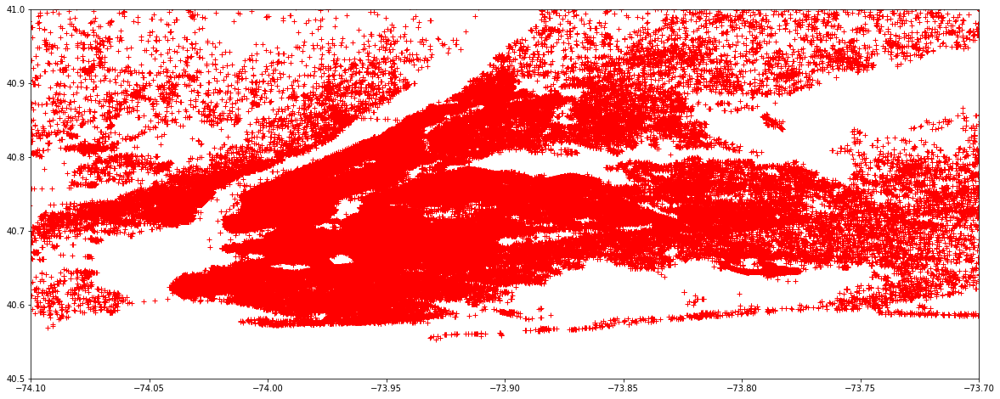

In [157]:
plt.figure(figsize=(20,8))
plt.plot(dframe['Lon'],dframe['Lat'],'r+')
plt.xlim(-74.1,-73.7)
plt.ylim(40.5,41)

## SPATIAL ANALYSIS using heatmap to get a clear cut of Rush

In [163]:
dframe_out=dframe[dframe['Weekdays']=='Sunday']

In [164]:
dframe_out.shape

(490180, 9)

In [166]:
dframe_out.head(10)

,Date/Time,Lat,Lon,Base,Weekdays,Day,Minutes,Month,Hour
6965,2014-04-06 00:00:00,40.6547,-74.3033,B02512,Sunday,6,0,4,0
6966,2014-04-06 00:00:00,40.7356,-74.0006,B02512,Sunday,6,0,4,0
6967,2014-04-06 00:00:00,40.7421,-74.0041,B02512,Sunday,6,0,4,0
6968,2014-04-06 00:00:00,40.7401,-74.0053,B02512,Sunday,6,0,4,0
6969,2014-04-06 00:01:00,40.7368,-73.9877,B02512,Sunday,6,1,4,0
6970,2014-04-06 00:01:00,40.7297,-73.9869,B02512,Sunday,6,1,4,0
6971,2014-04-06 00:01:00,40.7197,-74.0106,B02512,Sunday,6,1,4,0
6972,2014-04-06 00:01:00,40.7531,-74.0255,B02512,Sunday,6,1,4,0
6973,2014-04-06 00:03:00,40.7377,-73.9864,B02512,Sunday,6,3,4,0
6974,2014-04-06 00:09:00,40.7091,-73.9371,B02512,Sunday,6,9,4,0


In [167]:
dframe_rush=dframe_out.groupby(['Lat','Lon'])['Weekdays'].count().reset_index()

In [171]:
dframe_rush.columns=['Lat','Lon','No of Trips']

In [172]:
for i in range(101):
    print('Lat:{}\nLon:{}\nWeekdays:{}\n______________'.format(dframe_rush['Lat'][i],dframe_rush['Lon'][i],dframe_rush['No of Trips'][i]))

Lat:39.9374
Lon:-74.0722
Weekdays:1
______________
Lat:39.9378
Lon:-74.0721
Weekdays:1
______________
Lat:39.9384
Lon:-74.0742
Weekdays:1
______________
Lat:39.9385
Lon:-74.0734
Weekdays:1
______________
Lat:39.9415
Lon:-74.0736
Weekdays:1
______________
Lat:39.9416
Lon:-74.0736
Weekdays:1
______________
Lat:39.9417
Lon:-74.0737
Weekdays:1
______________
Lat:39.9504
Lon:-74.197
Weekdays:1
______________
Lat:39.9504
Lon:-74.1969
Weekdays:1
______________
Lat:39.9824
Lon:-74.0705
Weekdays:1
______________
Lat:39.9827
Lon:-74.0681
Weekdays:1
______________
Lat:40.0101
Lon:-74.2167
Weekdays:1
______________
Lat:40.067
Lon:-74.0687
Weekdays:1
______________
Lat:40.0803
Lon:-74.1254
Weekdays:1
______________
Lat:40.083
Lon:-74.0708
Weekdays:1
______________
Lat:40.0875
Lon:-74.0658
Weekdays:1
______________
Lat:40.0893
Lon:-74.043
Weekdays:1
______________
Lat:40.0937
Lon:-74.0374
Weekdays:1
______________
Lat:40.0938
Lon:-74.037
Weekdays:1
______________
Lat:40.0944
Lon:-74.0369
Weekdays:1


In [174]:
dframe_rush

,Lat,Lon,No of Trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [177]:
import folium

In [179]:
from folium.plugins import HeatMap

In [181]:
basemap=folium.Map()

In [183]:
HeatMap(dframe_rush,zoom=20,radius=15).add_to(basemap)
basemap

## AUTOMATING ANALYSIS OF LOCATION DATA POINTS AND SPATIAL ANALYSIS

In [216]:
def location_data_point_and_spatial_analysis_automated():
    day=input('Enter your day:')
    print('Plotting your charts------------------>')
    plt.figure(figsize=(20,8))
    dframe_out=dframe[dframe['Weekdays']==day]
    dframe_rush=dframe_out.groupby(['Lat','Lon'])['Weekdays'].count().reset_index()
    basemap=folium.Map()
    HeatMap(dframe_rush,zoom=20,radius=15).add_to(basemap)
    basemap2=folium.Map()
    print(basemap2)
    return basemap

In [217]:
location_data_point_and_spatial_analysis_automated()

Enter your day:Monday
Plotting your charts------------------>


<Figure size 1440x576 with 0 Axes>

In [211]:
location_data_point_and_spatial_analysis_automated()

Enter your day:Monday
Plotting your charts------------------>


<Figure size 1440x576 with 0 Axes>

In [212]:
location_data_point_and_spatial_analysis_automated()

Enter your day:Tuesday
Plotting your charts------------------>


<Figure size 1440x576 with 0 Axes>

In [213]:
location_data_point_and_spatial_analysis_automated()

Enter your day:Wednesday
Plotting your charts------------------>


<Figure size 1440x576 with 0 Axes>